# Building the Extended AI Dictionary
This notebook requires a running instance of the neo4j Graph Database with all the data from the steps before loaded and a built core dictionary. It will extend the core dictionary with the data from the graph database and save it as a new dictionary.

In [1]:
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
from sentence_transformers import SentenceTransformer

import logging
logging.basicConfig(level=logging.ERROR)

# Import plotly
import plotly.express as px

from tqdm.auto import tqdm
# register tqdm with pandas
tqdm.pandas()

import numpy as np
import ast

from hdbscan import HDBSCAN

# from helper.keyword_helper import get_tsne_coordinates, representation_generator
from helper.keyword_helper import get_tsne_coordinates

In [2]:
DICT_PATH = "data/dictionaries"
SAMPLE_SIZE = None

In [3]:
# Load the dictionary
if SAMPLE_SIZE is None:
    dict_df = pd.read_csv(f"{DICT_PATH}/dictionary_weights_w_embeddings.csv")
else:
    print(f"Loading {SAMPLE_SIZE} samples from the core dictionary")
    dict_df = pd.read_csv(f"{DICT_PATH}/dictionary_weights_w_embeddings.csv").sample(SAMPLE_SIZE, random_state=42)
print(f"Combined dictionary size: {dict_df.shape}")
display(dict_df.head(5))

Combined dictionary size: (16275, 3)


,keyword,weight,embedding
0,graph neural network,1.0,"[0.08722702413797379, 0.8745535016059875, -0.3..."
1,graph neuralnetworks,1.0,"[-0.11062880605459213, 0.9918195605278015, -0...."
2,graph neural networkand,1.0,"[0.1356668621301651, 0.8163174986839294, -0.59..."
3,graph neural networks based,1.0,"[-0.10963953286409378, 0.6333564519882202, -0...."
4,graph neural network based,1.0,"[-0.029546916484832764, 0.5460565686225891, -0..."


In [4]:
tsne_dict_df = dict_df.copy()

tsne_dict_df["embedding"] = tsne_dict_df["embedding"].progress_apply(ast.literal_eval)
x = np.array(tsne_dict_df["embedding"].tolist())
print(f"Shape of x_core: {x.shape}")
print(f"Shape of example from x_core: {x[0].shape}")

keyword_embeddings_tsne_2d = get_tsne_coordinates(x)
print(f"Shape of keyword_embeddings_tsne_2d_core: {keyword_embeddings_tsne_2d.shape}")

# Add the TSNE coordinates to the dataframe
tsne_dict_df["tsne_x"] = keyword_embeddings_tsne_2d[:,0]
tsne_dict_df["tsne_y"] = keyword_embeddings_tsne_2d[:,1]

  0%|          | 0/16275 [00:00<?, ?it/s]

Shape of x_core: (16275, 768)
Shape of example from x_core: (768,)
===> Finding 600 nearest neighbors using Annoy approximate search using cosine distance...
   --> Time elapsed: 11.74 seconds
===> Calculating affinity matrix...
   --> Time elapsed: 1.11 seconds
===> Calculating PCA-based initialization...
   --> Time elapsed: 0.29 seconds
--------------------------------------------------------------------------------
TSNE(early_exaggeration=12, n_jobs=8, verbose=True)
--------------------------------------------------------------------------------
===> Running optimization with exaggeration=12.00, lr=1356.25 for 250 iterations...
Iteration   50, KL divergence 4.5995, 50 iterations in 0.8991 sec
Iteration  100, KL divergence 4.6440, 50 iterations in 0.8746 sec
Iteration  150, KL divergence 4.6399, 50 iterations in 0.8777 sec
Iteration  200, KL divergence 4.6398, 50 iterations in 0.8714 sec
Iteration  250, KL divergence 4.6398, 50 iterations in 0.8688 sec
   --> Time elapsed: 4.39 seco

In [5]:
# Clustering
keyword_embeddings_hdbscan = HDBSCAN(
    min_cluster_size = 200,
    min_samples = 10,
    metric="euclidean",
    # cluster_selection_method="eom",
    cluster_selection_method="leaf",
    prediction_data=True,
    core_dist_n_jobs=8,
).fit(keyword_embeddings_tsne_2d)
print(f"Got {len(set(keyword_embeddings_hdbscan.labels_))} clusters")

# Add the cluster labels to the dataframe
tsne_dict_df["cluster"] = keyword_embeddings_hdbscan.labels_

Got 22 clusters


In [6]:
from transformers import pipeline
import torch

def representation_generator(keyword_list):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # print(f"Using device: {device}")
    model = "google/flan-t5-large"
    generator = pipeline('text2text-generation', model=model, device=device)
    # prompt = "I have a general topic described by the following keywords: [KEYWORDS]. Based on these keywords, what is this topic about? Be specific, precise and short! Don't use names or numbers!"
    representation_list = []
    for keywords in tqdm(keyword_list, desc="Generating representations..."):
        prompt = "Given the following phrases, come up with a topic name that is specific and precise, not general and maximum 3 words: [KEYWORDS]"
        keyword_string = ', '.join(keywords)[:2000]
        prompt = prompt.replace('[KEYWORDS]', keyword_string)
        representation_list.append(representation_generator_helper(generator, prompt))
    return representation_list

def representation_generator_helper(generator, prompt):
    # print(f"Generating representation for: {prompt}")
    representation = generator(
        prompt,
        max_length=10,
        do_sample=True,
        temperature=0.2
    )[0]['generated_text']
    # print(f"Representation: {representation}")
    return representation

In [7]:
# Generate representations for each cluster
cluster_keywords = tsne_dict_df.groupby('cluster')['keyword'].apply(list).reset_index()
display(cluster_keywords.head())

# Apply the function representation_generator to the list of keywords for each cluster
keywords_list = cluster_keywords['keyword'].tolist()
print(f"Length of keywords_list: {len(keywords_list)}")
print(f"Example of keywords_list: {keywords_list[0]}")
cluster_keywords['representation'] = representation_generator(keywords_list)
display(cluster_keywords.head())

# Assign each cluster its representation
tsne_dict_df_new = tsne_dict_df.merge(cluster_keywords[['cluster', 'representation']], on='cluster', how='left')
display(tsne_dict_df_new.head())

,cluster,keyword
0,-1,"[automatic speech recognition, deepvit archite..."
1,0,"[graph neural network, graph neuralnetworks, g..."
2,1,"[facial micro expression recognition, micro fa..."
3,2,"[knowledge graph application, knowledge graph ..."
4,3,"[variational autoencoders, variational autoenc..."


Length of keywords_list: 22
Example of keywords_list: ['automatic speech recognition', 'deepvit architecture', 'named entity recognition ner', 'named entity recognition model', 'named entity recognizers', 'named entity recognizer', 'supervised named entity recognition', 'named entity recognition', 'named entity identification', 'recognizing named entity', 'medical segmentation', 'medical image segmentation', 'unsupervised domain adaptation task', 'unsupervised domain adaptationuda', 'unsupervised domain adaptation', 'point cloud description', 'point cloud region', 'pointcloud', 'point cloud', 'data augmentation technique', 'stochastic co block model', 'stochastic block model', 'artificial intelligence', 'data augmentation method', 'data augmentation technology', 'machine translation system', 'automatic translation system', 'machine translation environment', 'test time', 'human pose estimation', 'human activity recognition', 'human activity recognitionhar', 'explainable artificial intel

Generating representations...:   0%|          | 0/22 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (524 > 512). Running this sequence through the model will result in indexing errors
/home/wilinski/.local/lib/python3.11/site-packages/transformers/pipelines/base.py:1101: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


,cluster,keyword,representation
0,-1,"[automatic speech recognition, deepvit archite...",human act
1,0,"[graph neural network, graph neuralnetworks, g...",graph convolutional network
2,1,"[facial micro expression recognition, micro fa...",emotion recognition
3,2,"[knowledge graph application, knowledge graph ...",knowledge distillation
4,3,"[variational autoencoders, variational autoenc...",variational autoencoders


,keyword,weight,embedding,tsne_x,tsne_y,cluster,representation
0,graph neural network,1.0,"[0.08722702413797379, 0.8745535016059875, -0.3...",2.028335,-78.599788,0,graph convolutional network
1,graph neuralnetworks,1.0,"[-0.11062880605459213, 0.9918195605278015, -0....",1.860052,-78.755494,0,graph convolutional network
2,graph neural networkand,1.0,"[0.1356668621301651, 0.8163174986839294, -0.59...",1.965191,-78.430846,0,graph convolutional network
3,graph neural networks based,1.0,"[-0.10963953286409378, 0.6333564519882202, -0....",1.867272,-78.264820,0,graph convolutional network
4,graph neural network based,1.0,"[-0.029546916484832764, 0.5460565686225891, -0...",1.841393,-78.212327,0,graph convolutional network


In [8]:
# Rename all rows with cluster = -1 to noise in column representation
tsne_dict_df_new.loc[tsne_dict_df_new['cluster'] == -1, 'representation'] = 'noise'

# Make a plotly scatter plot of all keywords. Color the keywords by their cluster label and group them by their source dictionary
fig = px.scatter(
    tsne_dict_df_new,
    x="tsne_x",
    y="tsne_y",
    color="representation",
    hover_name="keyword",
    opacity=tsne_dict_df_new["weight"],
    hover_data=["keyword", "cluster", "representation"])
# Save the plot
fig.write_html("plots/keyword_embeddings.html")
# Show the plot
fig.show()

Number of keywords: 16275
Number of keywords without noise: 10942


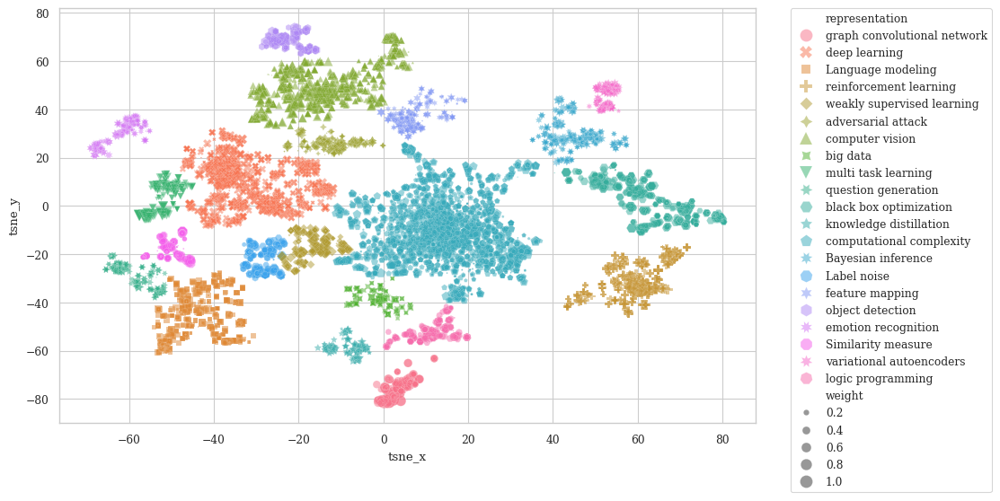

In [12]:
# Make a new plot using sns for a scientific publication
import seaborn as sns
import matplotlib.pyplot as plt

print(f"Number of keywords: {tsne_dict_df_new.shape[0]}")
# Exclude the noise
tsne_dict_df_new_no_noise = tsne_dict_df_new[tsne_dict_df_new["representation"] != "noise"]
print(f"Number of keywords without noise: {tsne_dict_df_new_no_noise.shape[0]}")

sns.set_style("whitegrid")
sns.set_context("paper")
sns.set_palette('colorblind')
plt.rcParams['font.family'] = "serif"

fig, ax = plt.subplots(figsize=(10, 6))
sns.scatterplot(
    data=tsne_dict_df_new_no_noise,
    x="tsne_x",
    y="tsne_y",
    hue="representation",
    style="representation",
    size = "weight",
    sizes=(1, 100),
    alpha = 0.5,
    s=100,
    ax=ax
)

# Put the legend out of the figure
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Font size for axes
FONT_SIZE = 12

plt.rc('font', size=FONT_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=FONT_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=FONT_SIZE)    # fontsize of the x and y labels

# Set the axis sizes    
plt.rc('xtick', labelsize=FONT_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=FONT_SIZE)    # fontsize of the tick labels

# Save the plot
fig.savefig("plots/keyword_embeddings_sns.svg", bbox_inches='tight')

# Also save it as high quality png
fig.savefig("plots/keyword_embeddings_sns.png", dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

Top keywords:                                  keyword    weight  \
0                   graph neural network  1.000000   
3            graph neural networks based  1.000000   
4             graph neural network based  1.000000   
1                   graph neuralnetworks  1.000000   
2                graph neural networkand  1.000000   
..                                   ...       ...   
67              deep neural networksmons  0.859547   
65                   neural network deep  0.859547   
64                   deep neural network  0.859547   
68        generative adversarial network  0.834800   
69  generative adversarial network based  0.834800   

                                            embedding  
0   [0.08722702413797379, 0.8745535016059875, -0.3...  
3   [-0.10963953286409378, 0.6333564519882202, -0....  
4   [-0.029546916484832764, 0.5460565686225891, -0...  
1   [-0.11062880605459213, 0.9918195605278015, -0....  
2   [0.1356668621301651, 0.8163174986839294, -0.59...  
.

<Figure size 1200x600 with 0 Axes>

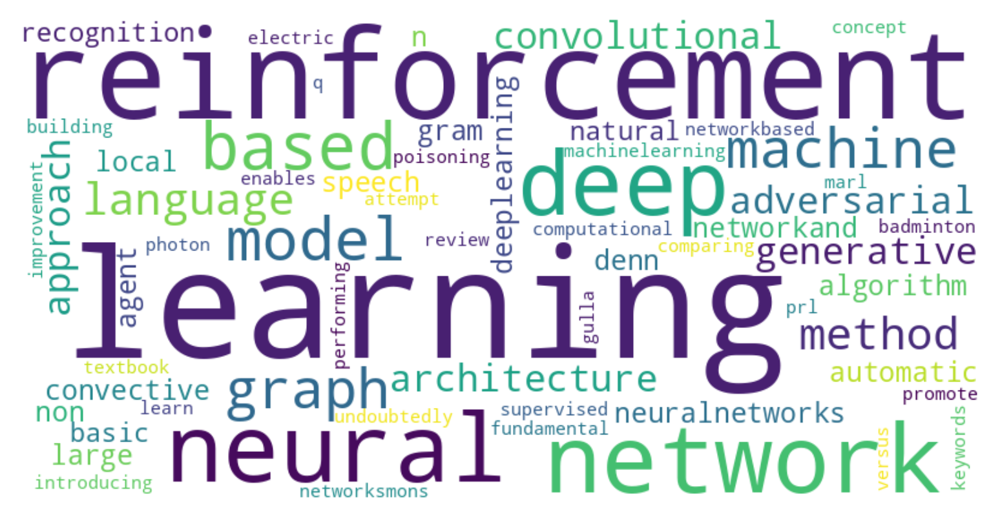

In [10]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Plot the top 40 keywords from the dictionary according to their weight
top_keywords = dict_df.sort_values(by="weight", ascending=False).head(70)
print(f"Top keywords: {top_keywords}")

# Generate a word cloud image
wordcloud = WordCloud(
    width=800,
    height=400,
    background_color="white",
    contour_width=3,
    contour_color='steelblue',
    collocations=False,
    random_state=42
    ).generate(' '.join(top_keywords["keyword"].tolist()))

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(12, 6))
# Make the figure high dpi
plt.figure(dpi=300)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Save the image as a high quality pdf
wordcloud.to_file("plots/wordcloud.png")